# exploring allosteric regulation by MD trajectory analysis 

## the logic and hypothesis of using RMSF explore allosteric regulation
The MWC and KNF model both suggest the two high/low affnity state of a protein/subunit. <br>
fluctuations of residues is description of the 'state'. <br>
by comparing different binding/inhibition and their permutations. <br>
We can find the significant residues that related to the binding,permutation changes.

In [8]:
%pylab inline
import os
import numpy as np
from matplotlib import pyplot as plt
import pytraj as pt

Populating the interactive namespace from numpy and matplotlib


## rmsf analysis 

In [2]:
runs='1rubp_rep01'
traj_dir='/Volumes/zhili_8TB/new_model/'
traj_path='/'.join([traj_dir,runs])
os.chdir(traj_path+'/MMGBSA/')                       #cd the trajectory path

traj = pt.iterload('*strip.nc', '*strip.parm7',stride=1) #load the striped trajectory
#superpose the trajectory to the first frame
pt.superpose(traj, ref=0)                  
#do rmsf on the last 1/4 frames of the trajectory. show results by residue.
rmsf_list=pt.rmsf(traj= traj[int(len(traj)*0.75):],mask='byres')    

#The multimeric proteins with identical subunit are usually believed to have allosteric effect
#eight repeating large subunits here in rubisco 
for subunit in range(8):    
    rep_rmsf=rmsf_list[subunit*477:subunit*477+477].T[1]    #447 residues in a large subunit 
    if subunit==0:
        rmsf_stack=rep_rmsf
    else: 
        rmsf_stack=np.vstack((rmsf_stack,rep_rmsf))

### check the distrubution of the rmsf values 

mode:  0.56
mean:  0.958921934513412


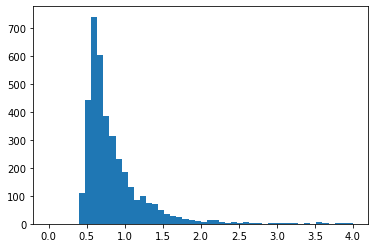

In [3]:
my_hist=hist(rmsf_stack.flatten(),bins=50,range=(0,4))
my_hist[1][np.where(my_hist[0])]

print('mode: ',my_hist[1][argmax(my_hist[0])])
print('mean: ',mean(rmsf_stack.flatten()))

ok most of residue's fluctuation is 0.56 A. 
The residues with high rmsf and large difference is of interest. 

### simple visualization of rmsf by residues. 

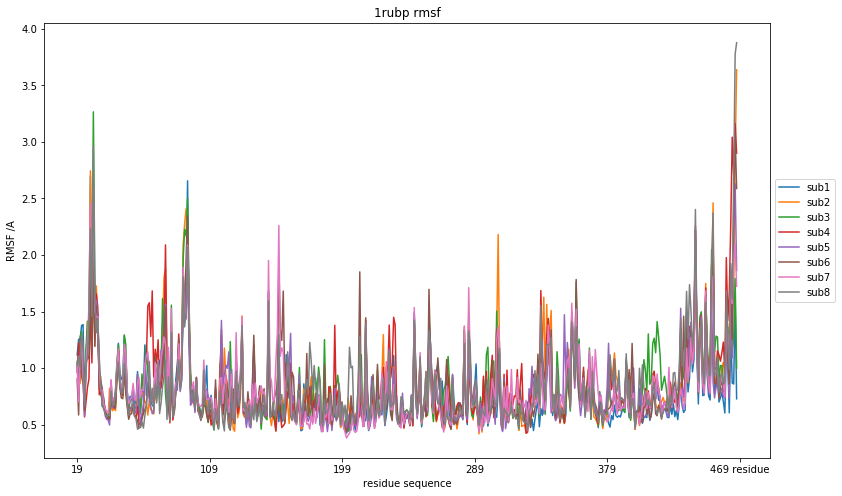

In [4]:
plt.figure(figsize = (13,8))
for i in range(8):

    plot(rmsf_stack[i][18:467],label='sub'+str(i+1))      
#do not visualize the head and tail residues, because they rmsf value and unlikely involves the allosteric regulation

plt.xticks(range(0,451,90),('19','109','199','289','379','469 residue'))
plt.xlabel('residue sequence')
plt.ylabel('RMSF /A')
plt.title('1rubp rmsf')
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))


The information contaions in the plot can be related to secondary structrues of the protein.
or the residue-residue contact relations.

In [5]:
import pandas as pd
import seaborn as sns

### divide the plot above into dimer

In [41]:
# calculate the rmsf, last 250 ns, large subunit,by residue, return a 
def rmsf_cal(runs):

    traj_dir='/Volumes/zhili_8TB/new_model/'
    traj_path='/'.join([traj_dir,runs])
    os.chdir(traj_path+'/MMGBSA/')                       #cd the trajectory path

    traj = pt.iterload('*strip.nc', '*strip.parm7',stride=1) #load the striped trajectory
    #superpose the trajectory to the first frame
    pt.superpose(traj, ref=0)                  
    #do rmsf on the last 1/4 frames of the trajectory. show results by residue.
    traj=traj[int(len(traj)*0.75)::int(len(traj)*0.25/250)]     # set to read 250 frames of last 250 ns 
    rmsf_list=pt.rmsf(traj,mask='byres')    

    #The multimeric proteins with identical subunit are usually believed to have allosteric effect
    #eight repeating large subunits here in rubisco 
    for subunit in range(8):    
        rep_rmsf=rmsf_list[subunit*477:subunit*477+477].T[1]    #447 residues in a large subunit 
        if subunit==0:
            rmsf_stack=rep_rmsf
        else: 
            rmsf_stack=np.vstack((rmsf_stack,rep_rmsf))
    return rmsf_stack

In [37]:
# Have a think about the secondary structure, is a region stablized by hydrogen bonds 
# in the polypeptide backbone. We can use dssp algorithm based on the hydrogen bonds of the 
# current structrue to assign the secondary strutures...
# So it is a frame based, dynamics dataset.
# But it is fine to use the crysatl structure to align with the reference data...
# this is just to simplify the visualization 
# to show how the residues devidation from initial structure in term of secondary structrue 
# from the metric of rmsf (fluctuation)

In [38]:
# use one Large subunit chanin for anaylsis
traj = pt.iterload('/Volumes/zhili_8TB/new_model/L1.pdb', 
                   '/Volumes/zhili_8TB/new_model/L1.pdb')
traj

pytraj.TrajectoryIterator, 1 frames: 
Size: 0.000164 (GB)
<Topology: 7350 atoms, 477 residues, 1 mols, non-PBC>
           

In [42]:
residues, ss, _ = pt.dssp(traj,simplified=True)

In [43]:
r1=0
dss=ss[0][0]
ss_type=['C']
ss_res=[1]
for i in range(477):  
    ds=ss[0][i]
    if ds!=dss:
        dss = ds
        r1=i
        r2=i-1
        ss_type.append(ds)
        ss_res.append(r2)
        ss_res.append(r1)
ss_res.append(476)

In [169]:
def make_annotate(ss_type,ss_res):
    plt.annotate('loop',xy=(-15,0.1),xytext=(-15,0.1),               #Adds another annotation for the text that you want
                annotation_clip=False)
    plt.annotate('helix',xy=(-15,0.02),xytext=(-15,0.02),               #Adds another annotation for the text that you want
            annotation_clip=False)
    plt.annotate('strand',xy=(-15,-0.04),xytext=(-15,-0.04),               #Adds another annotation for the text that you want
            annotation_clip=False)
    for i in range(len(ss_type)):

        if ss_type[i]=='C':
            x1=ss_res[i*2]
            x2=ss_res[i*2+1]
            plt.annotate('', xy=(x1,0.1),xytext=(x2,0.1),                   #Repeating for however many arrows you want under the axes
                arrowprops=dict(arrowstyle='fancy',facecolor='red'),
                annotation_clip=False)
        if ss_type[i]=='H':
            x1=ss_res[i*2]
            x2=ss_res[i*2+1]
            plt.annotate('', xy=(x1,0.02),xytext=(x2,0.02),                   #Repeating for however many arrows you want under the axes
                arrowprops=dict(arrowstyle='fancy',facecolor='green'),
                annotation_clip=False)
        if ss_type[i]=='E':
            x1=ss_res[i*2]
            x2=ss_res[i*2+1]
            plt.annotate('', xy=(x1,-0.04),xytext=(x2,-0.04),                   #Repeating for however many arrows you want under the axes
                arrowprops=dict(arrowstyle='fancy',facecolor='blue'),
                annotation_clip=False)
str_xtick=[]
for i in range(15):
    str_xtick.append(str(i*34+1))

In [179]:
# plot the dimer rmsf
def rmsf_dimer_plot(runs,rmsf_stack):
    for i in range(4):
        plt.figure(figsize = (13,8))


        plot(rmsf_stack[i*2],label='sub'+str(i*2+1))  
        plot(rmsf_stack[i*2+1],label='sub'+str(i*2+2))
        plt.xticks(range(0,477,34),str_xtick)
        make_annotate(ss_type,ss_res)
        plt.ylim(0.3,4)
        #plt.xlabel('residue sequence')
        plt.ylabel('RMSF /A')
        plt.title(runs+'rmsf in dimer'+str(i*2+1)+'-'+str(i*2+2))
        plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))

/Users/czl/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/Users/czl/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/Users/czl/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until 

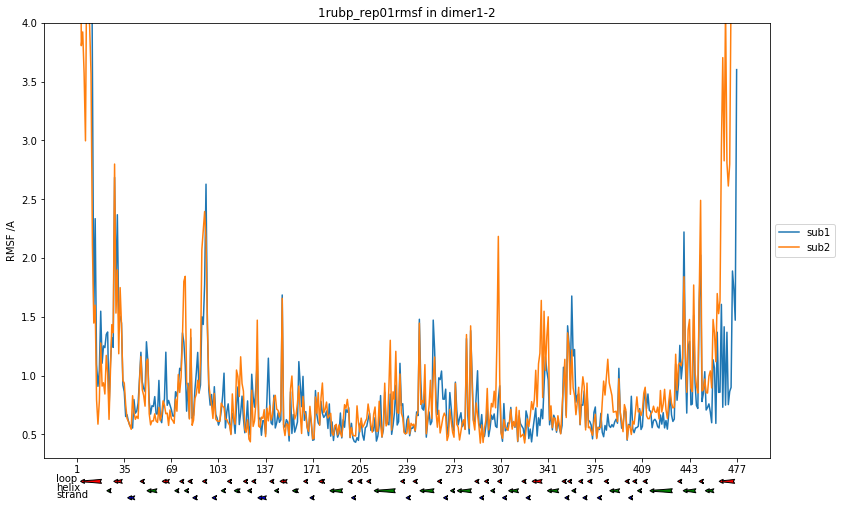

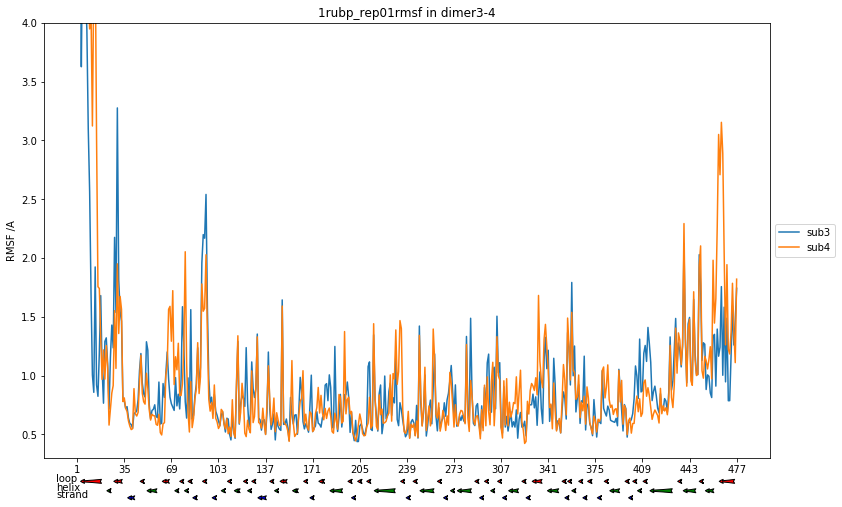

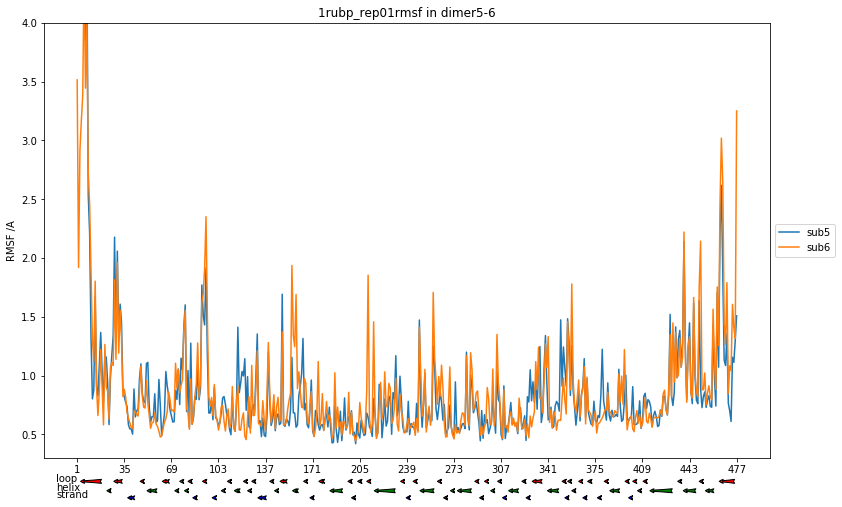

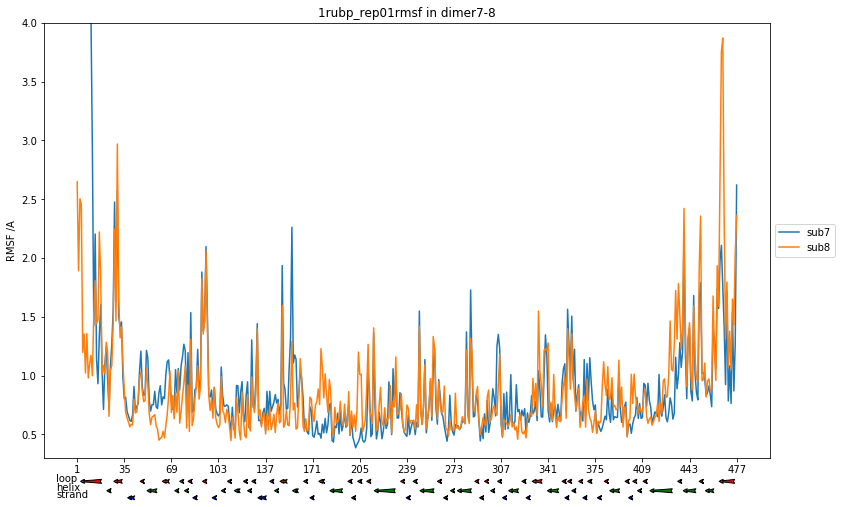

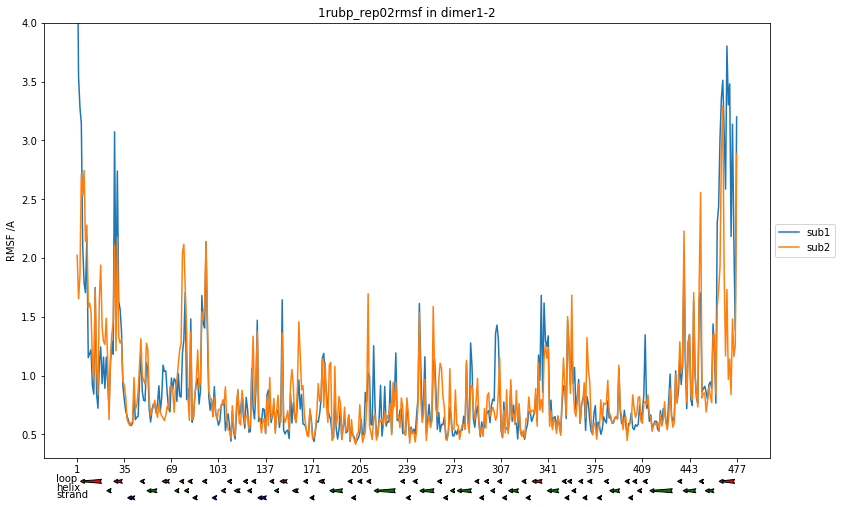

...

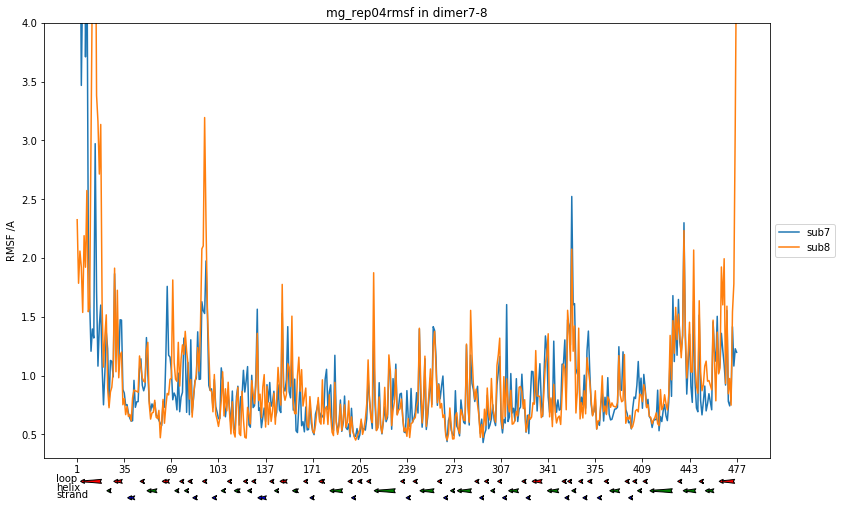

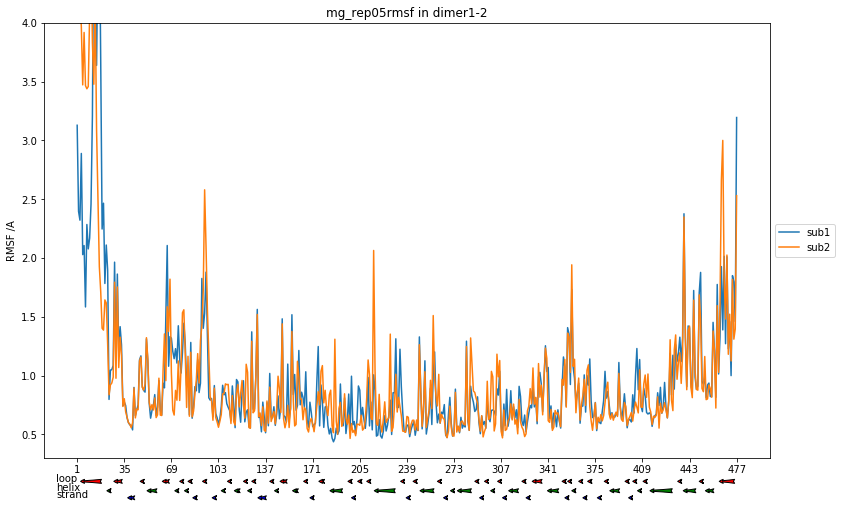

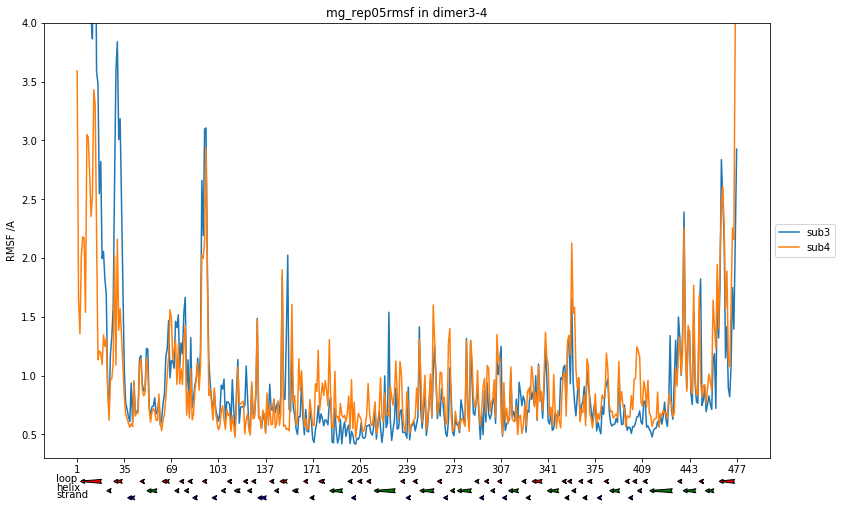

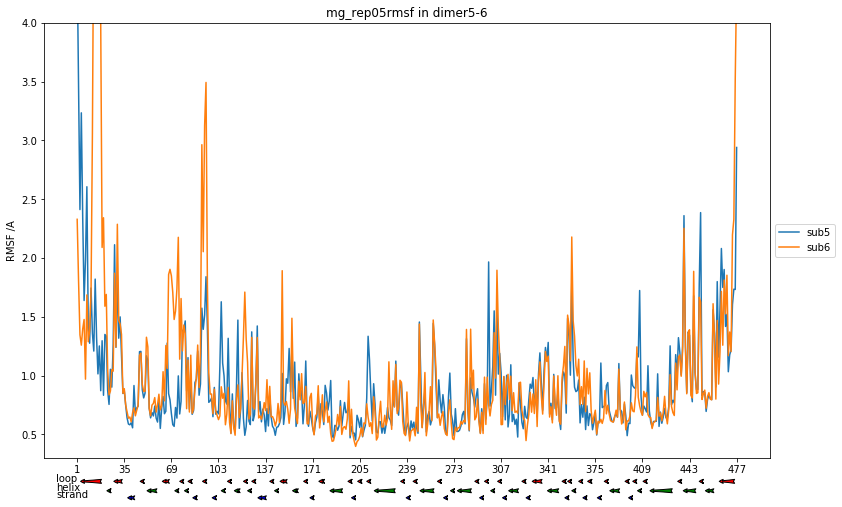

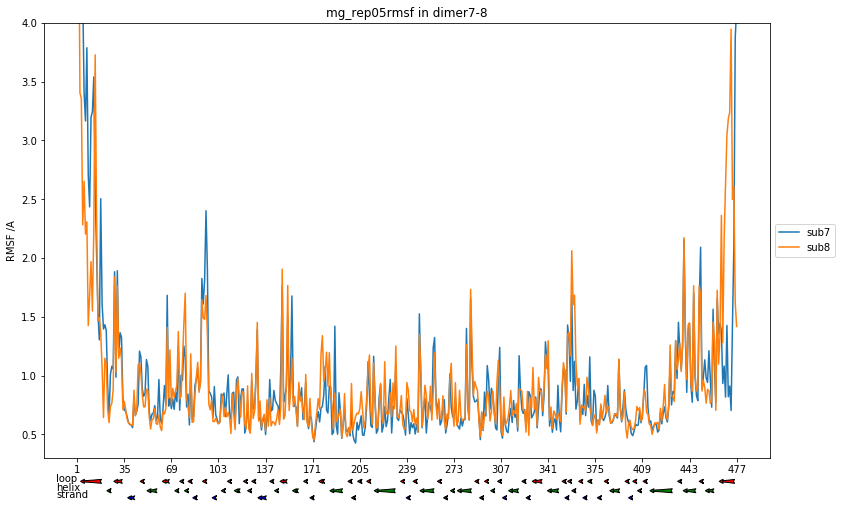

In [175]:
for runs in ['1rubp_rep01','1rubp_rep02','1rubp_rep03','1rubp_rep04','1rubp_rep05',
            '8rubp_1_rep01','8rubp_1_rep02','8rubp_1_rep03','8rubp_1_rep04','8rubp_1_rep05',
            'unact_rep01','unact_rep02','unact_rep03','unact_rep04','unact_rep05',
            'mg_rep01','mg_rep02','mg_rep03','mg_rep04','mg_rep05']:
    rmsf_stack=rmsf_cal(runs)
    rmsf_dimer_plot(runs,rmsf_stack)

In [109]:
# plot the dimer rmsf
def rmsf_dimer_sub_plot(runs,rmsf_stack):
    for i in range(4):
        j=0
        while j<i:
            plt.figure(figsize = (13,8))
            plot(rmsf_stack[j*2]-rmsf_stack[i*2],label='sub'+str(j*2+1)+'-'+str(i*2+1)) 
            plot(rmsf_stack[j*2+1]-rmsf_stack[i*2+1],label='sub'+str(j*2+2)+'-'+str(i*2+2))             
            plt.xticks(range(0,477,34),str_xtick)
            make_sub_annotate(ss_type,ss_res)
            plt.ylim(-2,2)
            #plt.xlabel('residue sequence')
            plt.ylabel('RMSF /A')
            plt.title(runs+'rmsf in dimer'+str(i*2+1)+'-'+str(i*2+2))
            plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
            j+=1

In [110]:
def make_sub_annotate(ss_type,ss_res):
    plt.annotate('loop',xy=(-15,0.08),xytext=(-15,0.08),               #Adds another annotation for the text that you want
                annotation_clip=False)
    plt.annotate('helix',xy=(-15,0),xytext=(-15,0),               #Adds another annotation for the text that you want
            annotation_clip=False)
    plt.annotate('strand',xy=(-15,-0.08),xytext=(-15,-0.08),               #Adds another annotation for the text that you want
            annotation_clip=False)
    for i in range(len(ss_type)):

        if ss_type[i]=='C':
            x1=ss_res[i*2]
            x2=ss_res[i*2+1]
            plt.annotate('', xy=(x1,0.08),xytext=(x2,0.08),                   #Repeating for however many arrows you want under the axes
                arrowprops=dict(arrowstyle='fancy',facecolor='red'),
                annotation_clip=False)
        if ss_type[i]=='H':
            x1=ss_res[i*2]
            x2=ss_res[i*2+1]
            plt.annotate('', xy=(x1,0),xytext=(x2,0),                   #Repeating for however many arrows you want under the axes
                arrowprops=dict(arrowstyle='fancy',facecolor='green'),
                annotation_clip=False)
        if ss_type[i]=='E':
            x1=ss_res[i*2]
            x2=ss_res[i*2+1]
            plt.annotate('', xy=(x1,-0.08),xytext=(x2,-0.08),                   #Repeating for however many arrows you want under the axes
                arrowprops=dict(arrowstyle='fancy',facecolor='blue'),
                annotation_clip=False)
str_xtick=[]
for i in range(15):
    str_xtick.append(str(i*34+1))

/Users/czl/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/Users/czl/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/Users/czl/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warnin

/Users/czl/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/Users/czl/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/Users/czl/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warnin

/Users/czl/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/Users/czl/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/Users/czl/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warnin

/Users/czl/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/Users/czl/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/Users/czl/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warnin

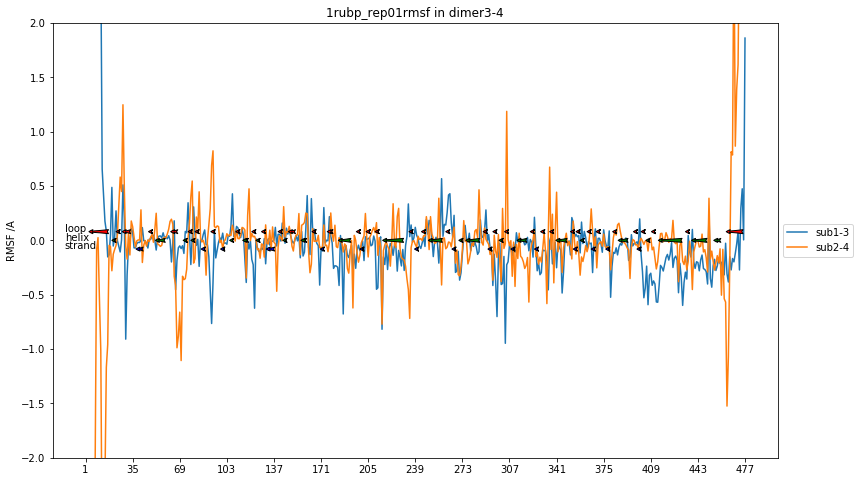

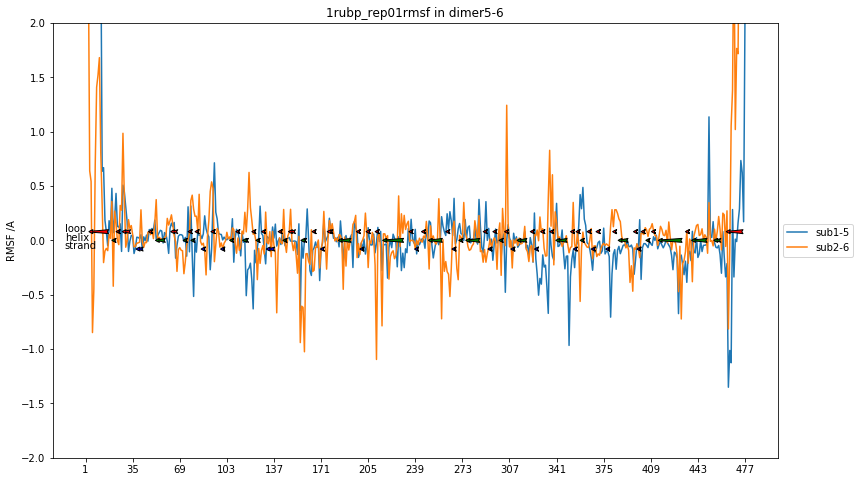

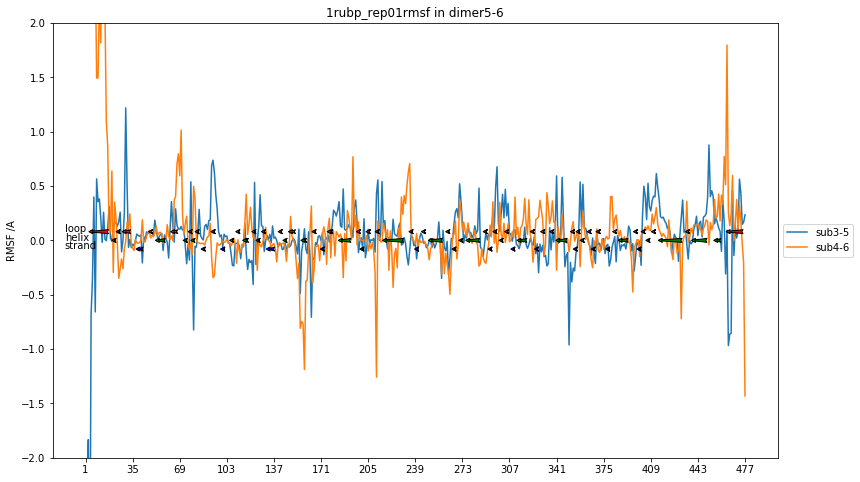

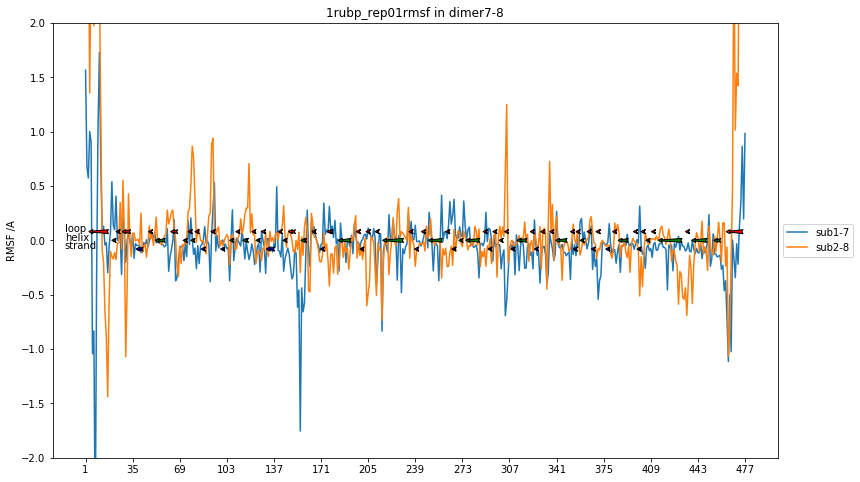

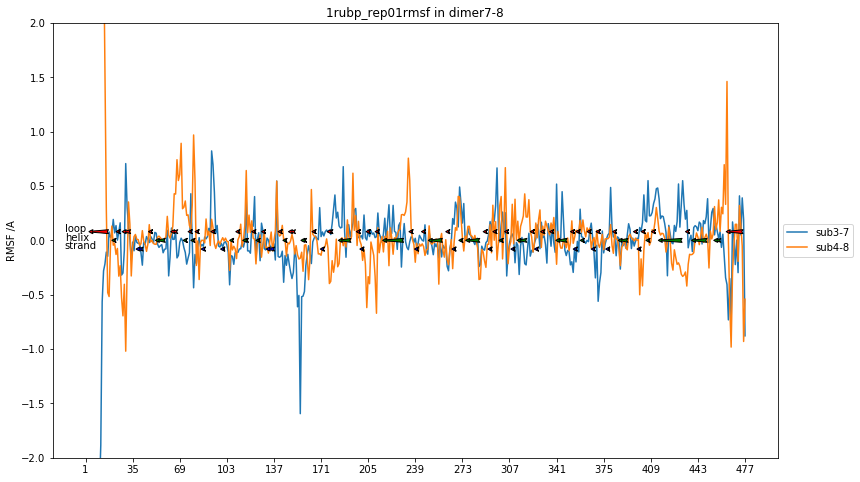

...

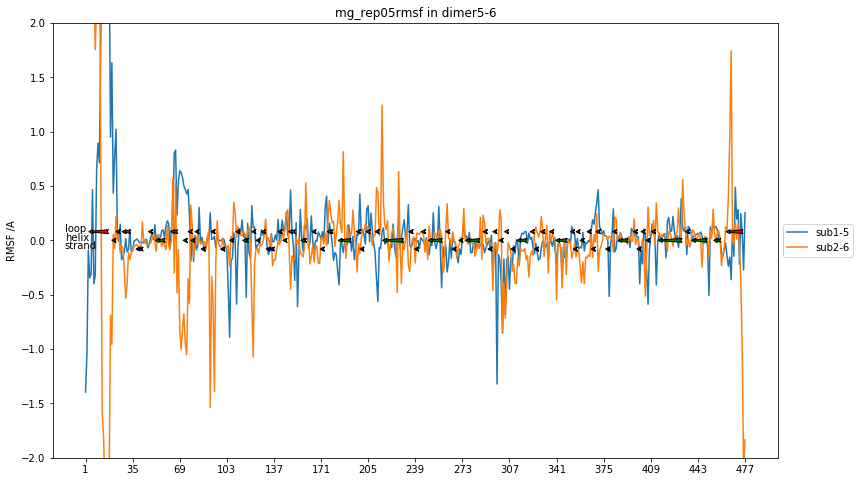

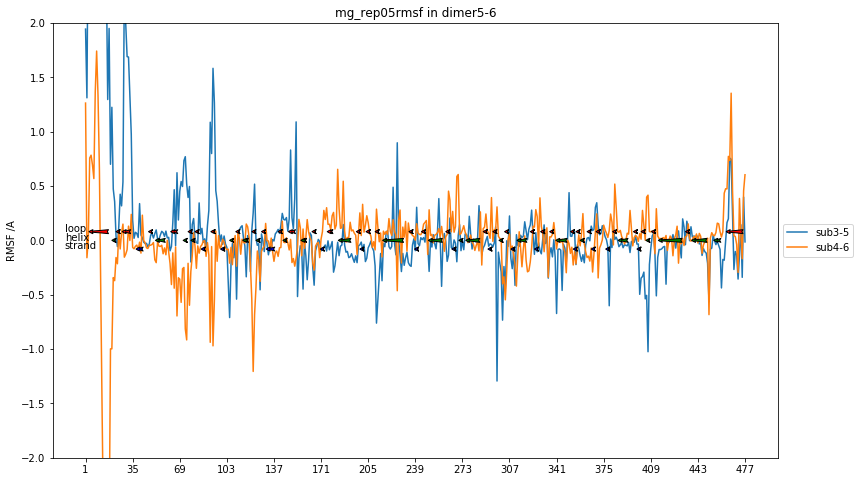

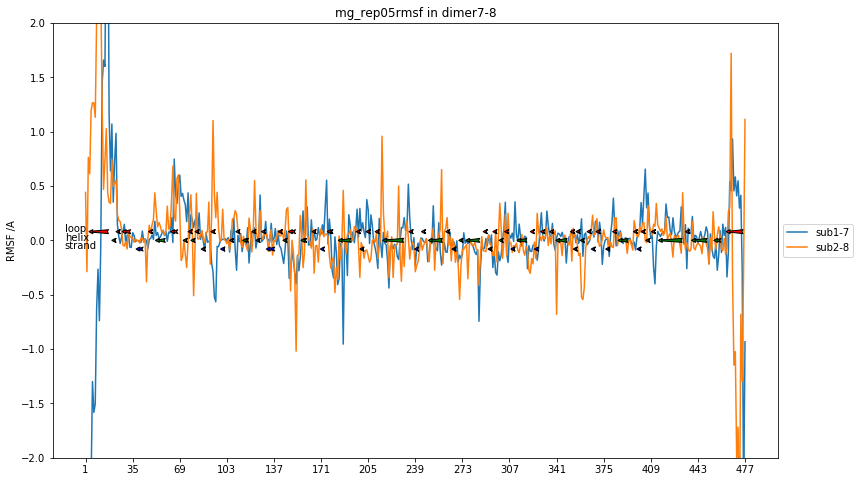

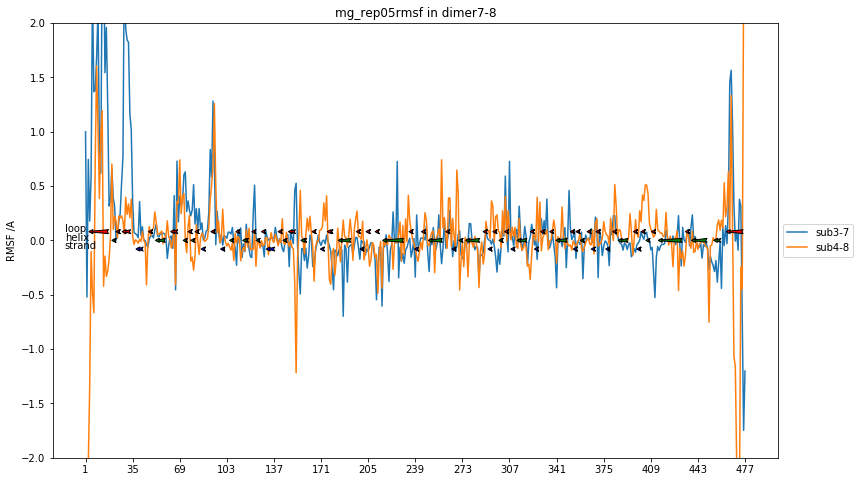

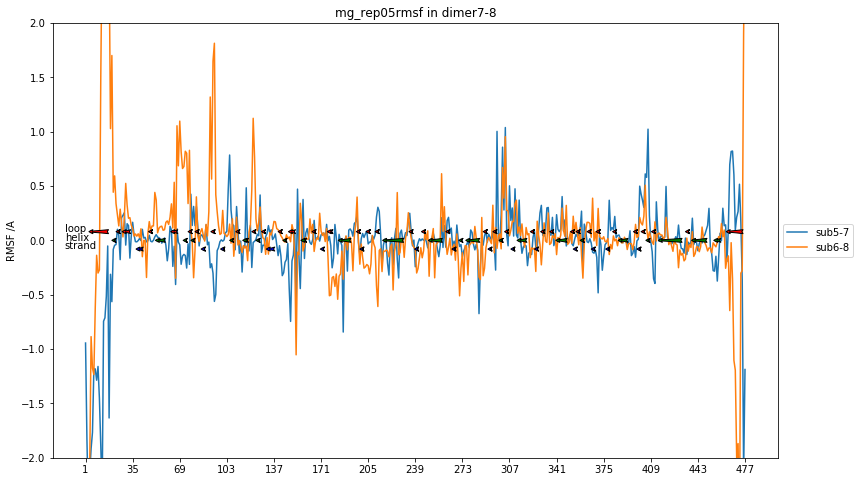

In [111]:
for runs in ['1rubp_rep01','1rubp_rep02','1rubp_rep03','1rubp_rep04','1rubp_rep05',
            '8rubp_1_rep01','8rubp_1_rep02','8rubp_1_rep03','8rubp_1_rep04','8rubp_1_rep05',
            'unact_rep01','unact_rep02','unact_rep03','unact_rep04','unact_rep05',
            'mg_rep01','mg_rep02','mg_rep03','mg_rep04','mg_rep05']:
    rmsf_stack=rmsf_cal(runs)
    rmsf_dimer_sub_plot(runs,rmsf_stack)

In [ ]:
#fuul residue rmsf

In [77]:
# plot the 8 dimer rmsf in one plot. 
def rmsf_alldimer_plot(runs,rmsf_stack):

    plt.figure(figsize = (104,8))
    plot(rmsf_stack.flatten(),label=runs)  
    plt.xticks(range(0,3816,53),str_xtick2)
    make_annotate(ss_type,ss_res)
    plt.ylim(0.3,4)
    #plt.xlabel('residue sequence')
    plt.ylabel('RMSF /A')
    plt.title(runs+'rmsf in all subunits')
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))

In [78]:
def make_annotate(ss_type,ss_res):
    plt.annotate('loop',xy=(-15,0.1),xytext=(-15,0.1),               #Adds another annotation for the text that you want
                annotation_clip=False)
    plt.annotate('helix',xy=(-15,0.02),xytext=(-15,0.02),               #Adds another annotation for the text that you want
            annotation_clip=False)
    plt.annotate('strand',xy=(-15,-0.04),xytext=(-15,-0.04),               #Adds another annotation for the text that you want
            annotation_clip=False)
    for i in range(len(ss_type)):

        if ss_type[i]=='C':
            x1=ss_res[i*2]
            x2=ss_res[i*2+1]
            plt.annotate('', xy=(x1,0.1),xytext=(x2,0.1),                   #Repeating for however many arrows you want under the axes
                arrowprops=dict(arrowstyle='fancy',facecolor='red'),
                annotation_clip=False)
        if ss_type[i]=='H':
            x1=ss_res[i*2]
            x2=ss_res[i*2+1]
            plt.annotate('', xy=(x1,0.02),xytext=(x2,0.02),                   #Repeating for however many arrows you want under the axes
                arrowprops=dict(arrowstyle='fancy',facecolor='green'),
                annotation_clip=False)
        if ss_type[i]=='E':
            x1=ss_res[i*2]
            x2=ss_res[i*2+1]
            plt.annotate('', xy=(x1,-0.04),xytext=(x2,-0.04),                   #Repeating for however many arrows you want under the axes
                arrowprops=dict(arrowstyle='fancy',facecolor='blue'),
                annotation_clip=False)
str_xtick2=[]
for i in range(73):
    str_xtick2.append(str(i*53))

In [107]:
def rmsf_output_filter_res(runs,rmsf_stack):
    res_seq=np.arange(1,477*8+1,1)
    rmsf_flat=rmsf_stack.flatten()
    res_seq=res_seq[rmsf_flat>2]
    #res_seq=res_seq.astype(int)
    f_name='/Users/czl/input_collection/amber_MD_script_for_rubisco/allosteric_analysis/'+runs+'.out'
    np.savetxt(f_name,res_seq[np.newaxis],fmt='%i',delimiter =',')

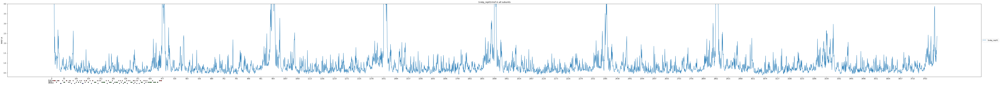

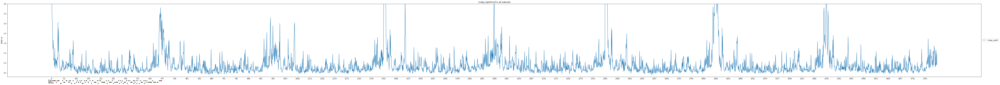

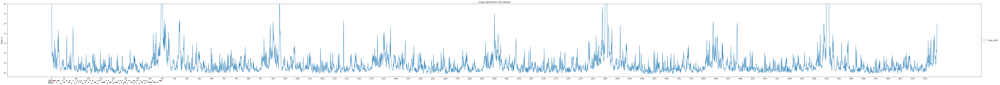

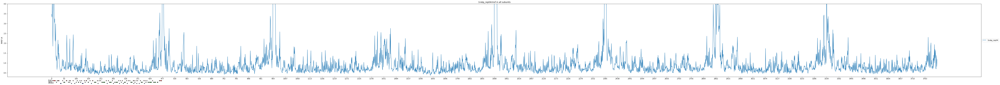

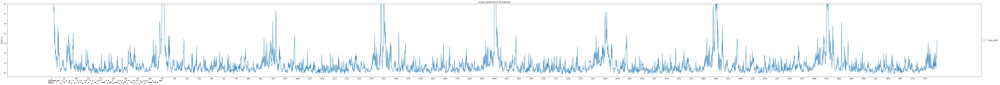

...

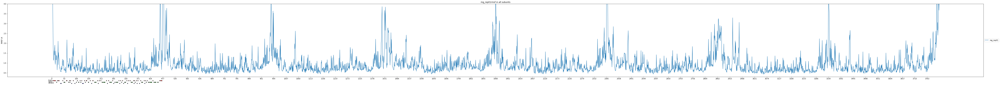

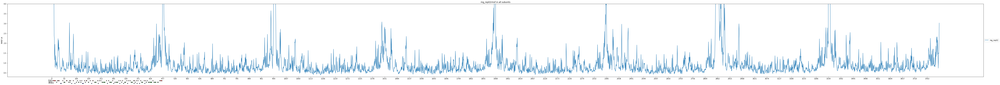

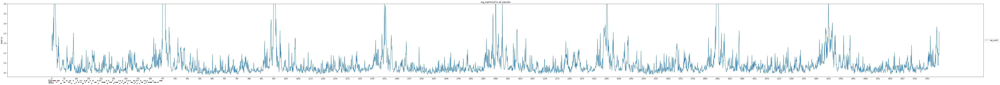

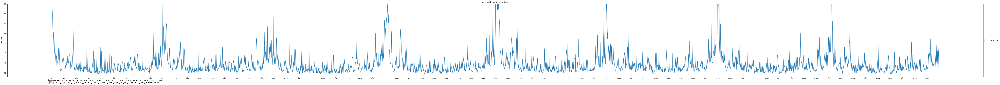

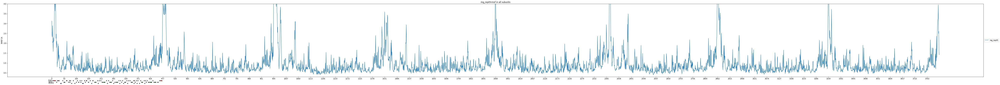

In [108]:
for runs in ['1rubp_rep01','1rubp_rep02','1rubp_rep03','1rubp_rep04','1rubp_rep05',
            '8rubp_1_rep01','8rubp_1_rep02','8rubp_1_rep03','8rubp_1_rep04','8rubp_1_rep05',
            'unact_rep01','unact_rep02','unact_rep03','unact_rep04','unact_rep05',
            'mg_rep01','mg_rep02','mg_rep03','mg_rep04','mg_rep05']:
    rmsf_stack=rmsf_cal(runs)
    rmsf_alldimer_plot(runs,rmsf_stack)
    rmsf_output_filter_res(runs,rmsf_stack)

In [191]:
def write_avg_pdb(runs):
    output_path="/Users/czl/input_collection/amber_MD_script_for_rubisco/allosteric_analysis"
    traj_dir='/Volumes/zhili_8TB/new_model/'
    traj_path='/'.join([traj_dir,runs])
    os.chdir(traj_path+'/MMGBSA/')                       #cd the trajectory path
    traj = pt.iterload('*strip.nc', '*strip.parm7',stride=1) #load the striped trajectory
    #superpose the trajectory to the first frame
    pt.superpose(traj, ref=0)                  
    #do rmsf on the last 1/4 frames of the trajectory. show results by residue.
    traj=traj[int(len(traj)*0.75)::int(len(traj)*0.25/250)]     # set to read 250 frames of last 250 ns 
    output_fn='/'.join([output_path,runs])
    mean_structure=pt.mean_structure(traj,dtype='traj')
    pt.write_traj(output_fn+"_avg.pdb", mean_structure, overwrite=True)
    

In [193]:
for runs in ['1rubp_rep01','1rubp_rep02','1rubp_rep03','1rubp_rep04','1rubp_rep05',
            '8rubp_1_rep01','8rubp_1_rep02','8rubp_1_rep03','8rubp_1_rep04','8rubp_1_rep05',
            'unact_rep01','unact_rep02','unact_rep03','unact_rep04','unact_rep05',
            'mg_rep01','mg_rep02','mg_rep03','mg_rep04','mg_rep05']:
    write_avg_pdb(runs)

In [ ]:
#copy the significant residues from the out files and select and show then on chimera

In [32]:
import nglview as nv


In [33]:
os.chdir("/Users/czl/input_collection/amber_MD_script_for_rubisco/allosteric_analysis") 

In [34]:
!pwd

/Users/czl/input_collection/amber_MD_script_for_rubisco/allosteric_analysis


In [35]:
traj = pt.load('avg_6PG.pdb')
traj

pytraj.Trajectory, 1 frames: 
Size: 0.001693 (GB)
<Topology: 75731 atoms, 4842 residues, 17 mols, non-PBC>
           

In [37]:
nv.color.ColormakerRegistry.add_selection_scheme(
    "my_custom_scheme", [["red", "101-200"]])

view=nv.show_pytraj(traj,default_representation=False)
view.add_cartoon(color="my_custom_scheme")
#view.add_ball_and_stick("ligand")
view.center()
view

NGLWidget()